!pip3 install plotly
!pip3 install nbformat
!pip install -q catboost 
!pip install -q lightgbm
!pip install seaborn

In [1]:
import pandas as pd
import numpy as np
from datetime import datetime 

#plot
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
%matplotlib inline

#modle
import time
import lightgbm as lgb
import xgboost as xgb
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score

In [3]:
#load the data
data= pd.read_csv("2010to2017nsWithoutNA.csv")
#data = data[100000:]

In [ ]:
data

In [ ]:
data.info()

## Transfer time formats

In [4]:
data['date']=data['date'].round(0).astype("int").astype("string")
data['time']=data['time'].round(0).astype("int").astype("string")
data['qualityflag']=data['qualityflag'].round(0).astype("int")
# data['qualityflag']=data['qualityflag'].round(0).astype("int").astype("string")
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag
0,15,9.65706,53.57080,12.0,20100121,3.0,0.0005,33.658676,0
1,15,9.65226,53.57170,11.0,20100121,3.0,0.0026,33.658894,0
2,15,9.64802,53.57256,13.0,20100121,3.0,0.0015,33.658823,0
3,15,9.64354,53.57392,12.0,20100121,3.0,0.0018,33.658896,0
4,15,9.63918,53.57548,13.0,20100121,3.0,0.0010,33.658877,0
...,...,...,...,...,...,...,...,...,...
220607,7,355.97763,49.09174,0.0,20150111,3.5,14.0350,35.358181,0
220608,7,355.97485,49.09552,0.0,20150111,3.5,14.0310,35.358089,0
220609,7,355.97018,49.10169,0.0,20150111,3.5,14.0280,35.356300,0
220610,7,355.96609,49.10715,0.0,20150111,3.5,14.0340,35.356022,0


In [5]:
data['datetime'] = pd.to_datetime(data['date'].str.cat(data['time'], sep = ':'), format= '%Y%m%d:%H')
data.sort_values("datetime", ascending=True, inplace=True)
data

,time,Longitude,Latitude,botDepth,date,depth,temperature,salinity,qualityflag,datetime
128084,0,358.94821,55.60880,0.0,20100114,3.5,6.4320,34.665810,0,2010-01-14 00:00:00
125653,0,3.43159,53.00650,0.0,20100114,3.5,5.6820,34.784801,0,2010-01-14 00:00:00
124334,0,2.66470,51.80500,0.0,20100114,3.5,6.6440,34.866791,0,2010-01-14 00:00:00
124335,0,2.65100,51.81740,0.0,20100114,3.5,6.6400,34.883789,0,2010-01-14 00:00:00
124336,0,2.63139,51.83490,0.0,20100114,3.5,6.7640,34.892792,0,2010-01-14 00:00:00
...,...,...,...,...,...,...,...,...,...,...
108502,23,6.75610,54.98440,30.0,20150310,3.0,5.7161,34.080087,0,2015-03-10 23:00:00
108503,23,6.75622,54.98450,30.0,20150310,3.0,5.7135,34.079856,0,2015-03-10 23:00:00
108504,23,6.75603,54.98441,30.0,20150310,3.0,5.7198,34.080419,0,2015-03-10 23:00:00
107779,23,8.07243,54.75209,8.0,20150310,3.0,5.0479,34.012564,0,2015-03-10 23:00:00


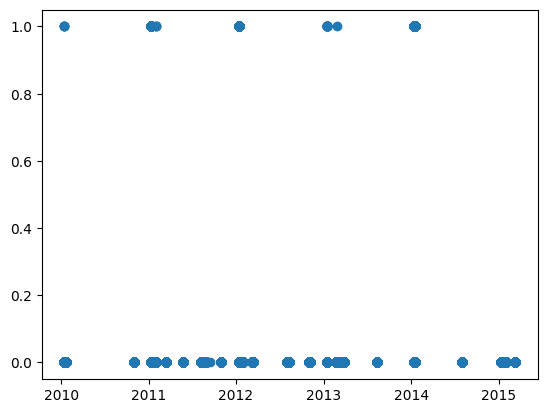

In [6]:
plt.scatter(data.datetime, data.qualityflag)
plt.show()

In [7]:
data = data.drop(['time', 'date'], axis=1)
data["datetime"] = data["datetime"].apply(lambda x: x.timestamp())
cols = ['datetime','Longitude','Latitude','botDepth','depth','temperature','salinity','qualityflag']
data = data.reindex(columns=cols)
data

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
128084,1.263427e+09,358.94821,55.60880,0.0,3.5,6.4320,34.665810,0
125653,1.263427e+09,3.43159,53.00650,0.0,3.5,5.6820,34.784801,0
124334,1.263427e+09,2.66470,51.80500,0.0,3.5,6.6440,34.866791,0
124335,1.263427e+09,2.65100,51.81740,0.0,3.5,6.6400,34.883789,0
124336,1.263427e+09,2.63139,51.83490,0.0,3.5,6.7640,34.892792,0
...,...,...,...,...,...,...,...,...
108502,1.426028e+09,6.75610,54.98440,30.0,3.0,5.7161,34.080087,0
108503,1.426028e+09,6.75622,54.98450,30.0,3.0,5.7135,34.079856,0
108504,1.426028e+09,6.75603,54.98441,30.0,3.0,5.7198,34.080419,0
107779,1.426028e+09,8.07243,54.75209,8.0,3.0,5.0479,34.012564,0


## Z-score normalization 

In [8]:
cl=len(cols)-1
df=data.copy()
for i in range(0,cl):
    mean = data.iloc[:,i].mean()
    std = np.std(data.iloc[:,i])
    df.iloc[:,i] = data.iloc[:,i].apply(lambda x: (x - mean) / std)
    
print(df)
print(data)

        datetime  Longitude  Latitude  botDepth     depth  temperature  \
128084 -1.732023   2.099265  0.752209 -0.381173  0.693024    -0.784248   
125653 -1.732023  -0.486042 -0.297482 -0.381173  0.693024    -0.929445   
124334 -1.732023  -0.491618 -0.782132 -0.381173  0.693024    -0.743205   
124335 -1.732023  -0.491718 -0.777130 -0.381173  0.693024    -0.743980   
124336 -1.732023  -0.491861 -0.770071 -0.381173  0.693024    -0.719974   
...          ...        ...       ...       ...       ...          ...   
108502  1.562493  -0.461866  0.500345  0.031783 -0.216042    -0.922844   
108503  1.562493  -0.461865  0.500385  0.031783 -0.216042    -0.923347   
108504  1.562493  -0.461866  0.500349  0.031783 -0.216042    -0.922127   
107779  1.562493  -0.452294  0.406638 -0.271052 -0.216042    -1.052205   
109978  1.562493  -0.466691  0.207921  0.100609 -0.216042    -0.881337   

        salinity  qualityflag  
128084  0.076151            0  
125653  0.159934            0  
124334  0.21766

In [48]:
data=df
data.to_csv('seadatanet.csv', index=False)

In [ ]:
plt.scatter(data.datetime, data.qualityflag)
plt.show()

In [10]:
instance = data[(data['qualityflag']==1)]
rate=len(instance)/len(data)*100
print(rate)

0.6948851377078309


In [11]:
def plotCluster(data,name1,name2,name3,label,start,end):   

    data1=data.loc[data[label] == 1]
    #print(data1)

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]


    data2=data.loc[data[label] == 0]
    #print(data2)

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  # [ 0  3  6  9 12 15 18 21]
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  # [ 1  4  7 10 13 16 19 22]
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  # [ 2  5  8 11 14 17 20 23]

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    #ax = Axes3D(fig)
    ax.scatter(x1, y1, z1, c='r',s=10, label='Abnormal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='Normal Data')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('scatter.png')
    
    #violin
    fig = px.violin(data, y=name1,color=label)
    fig.show()
    fig = px.violin(data, y=name2,color=label)
    fig.show()
    fig = px.violin(data, y=name3,color=label)
    fig.show()
    


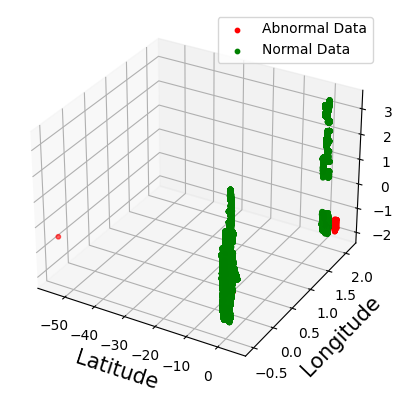

<Figure size 640x480 with 0 Axes>

In [12]:
dataplot=data.copy()
#dataplot['qualityflag']=y
#plot 3D figure by any three features

plotCluster(dataplot,'temperature','Longitude','Latitude','qualityflag',0,data.shape[0])

## test set
### random 10%  
test1
### and  last 10%
test2

In [13]:
#split the data and make sure the proportion in train and test set are equal
def getRandomSplit(data, size):
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.model_selection import train_test_split
    train_set, test_set = train_test_split(data, test_size = size,random_state = 42)
#    split = StratifiedShuffleSplit(n_splits = 1,test_size = size,random_state = 42)

#     for train_index,test_index in split.split(data,data.iloc[:,-1]):
#         train_set = data.iloc[train_index,:]
#         test_set = data.iloc[test_index,:]

    print(len(train_set),len(test_set))
    return train_set,test_set
    

In [14]:
#split the last 10% data 

# window
def sliding_window(data, window_size):
    # from last raw
    for i in range(len(data)-1, window_size-2, -1):
        data_slice = data[i-window_size+1:i+1]
        ratio = (data_slice["qualityflag"] == 1).sum() / window_size*100
        #print(ratio)
        if rate*0.9 <= ratio <= rate*1.1:
            #print(data_slice)
            return data_slice



def getLastSplit(data, size):
    data.sort_values("datetime", ascending=True, inplace=True)
    print(data)
    row,col=data.shape
    window_size = int(size*row)
    test_set=sliding_window(data, window_size)
    time = test_set.iloc[0,0]
    #print(time)
    train_set = data[data['datetime'] < time]
    print(len(train_set),len(test_set))
    return train_set,test_set
# windows keep the same rate of anomaly

In [19]:
#sampling
train_set1,test_set1 = getRandomSplit(data,0.3)
#train_set2,test_set2 = getLastSplit(data,0.1)

154428 66184


In [20]:
# train_set1 = train_set1.sample(n=167516)
#print(train_set1.shape)

In [21]:
train_set1.head()
test_set1.head()

,datetime,Longitude,Latitude,botDepth,depth,temperature,salinity,qualityflag
181235,0.826375,-0.453771,0.126424,-0.381173,0.693024,-1.031665,-1.354000,0
170983,0.826156,-0.508014,-1.560770,-0.381173,0.693024,-0.223978,-1.245229,0
58458,-0.698379,-0.457168,0.092904,-0.037043,-0.216042,1.429146,0.487046,0
182237,0.826229,-0.480467,0.431590,-0.381173,0.693024,-0.802059,0.127179,0
197371,1.460011,-0.505773,-1.474030,-0.381173,0.693024,-0.203263,-0.701899,0


In [22]:
instance = test_set1[(test_set1['qualityflag']==1)]
rate=len(instance)/len(test_set1)*100
print(rate)

0.6965429711108425


In [46]:
train_set1.to_csv('./randomtrain/seadatanet.csv', index=False)
test_set1.to_csv('./randomtest/seadatanet.csv', index=False)

In [ ]:
print(test_set2)

In [ ]:
print(train_set2)

In [ ]:
instance = test_set2[(test_set2['qualityflag']==1)]
rate=len(instance)/len(test_set2)*100
print(rate)

In [ ]:
plt.scatter(train_set2.datetime, train_set2.qualityflag)
plt.show()

In [ ]:
plt.scatter(test_set2.datetime, test_set2.qualityflag)
plt.show()

## supervised ml

In [23]:
params = {'num_leaves': 60, 
          'min_data_in_leaf': 30,
          'objective': 'binary', 
          'max_depth': -1,
          'learning_rate': 0.03,
          "min_sum_hessian_in_leaf": 6,
          "boosting": "gbdt",
          "feature_fraction": 0.9,
          "bagging_freq": 1,
          "bagging_fraction": 0.8,
          "bagging_seed": 11,
          "verbosity": -1,
          "random_state": 2019,
          }




In [24]:
lgb_params = {
    'boosting_type': 'gbdt',
    'objective': 'binary',
    'n_estimators': 100000,
    'learning_rate': 0.1,
    'random_state': 2948,
    'bagging_freq': 8,
    'bagging_fraction': 0.80718,
    'feature_fraction': 0.7,  # 0.3
    'feature_fraction_seed': 11,
    'max_depth': 9,
    'min_data_in_leaf': 40,
    'min_child_weight': 0.18654,
    "min_split_gain": 0.35079,
    'min_sum_hessian_in_leaf': 1.11347,
    'num_leaves': 29,
    'num_threads': 4,
    "lambda_l1": 0.55831,
    'lambda_l2': 1.67906,
    'cat_smooth': 10.4,
    'subsample': 0.7,
    'colsample_bytree': 0.7,
    'n_jobs': -1,
    'metric': 'auc'
}

In [25]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre)
    recall=recall_score(y_tru,y_pre)
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre)
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("balanced acc:",bac)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    
    # confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})

In [26]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf1 = model

    param_dist = dist
    grid = RandomizedSearchCV(clf1,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [27]:
def classSuper(train_set,test_set):
    x,y=data.shape
    score=[]
    models=[]
    # fit model and predict
    
    
    ##lightgbm
    print("lightgbm")
    clf1 = lgb.LGBMClassifier()
    clf1 = clf1.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre1=clf1.predict(test_set.iloc[:,0:y-1])
    y_tru1=test_set.iloc[:,y-1]
    computeMetric(y_tru1,y_pre1)
    
    
    
    
    ## GradientBoosting
    print("GradientBoosting")
    from sklearn.ensemble import GradientBoostingClassifier
    clf2 = GradientBoostingClassifier()
    clf2.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre2 = clf2.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre2)
    
    ##catboost
    print("catboost")
    clf3 = CatBoostClassifier(loss_function='Logloss')
    clf3.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre3 = clf3.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre3)

    
    
    
    #KNN
    print("KNN")
    from sklearn.neighbors import KNeighborsClassifier
    clf4 = KNeighborsClassifier()
    dic4={'n_neighbors':[1,2,3,4,5,6,7,8,9]}
    #para11=getPar(clf11,dic11,p_set,10)
    clf4 = KNeighborsClassifier(n_jobs=-1)
    clf4.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])

    y_pre4=clf4.predict(test_set.iloc[:,0:y-1])
    computeMetric(y_tru1,y_pre4)
    
#     #MLP
#     print("MLP")
#     from sklearn.neural_network import MLPClassifier
#     clf5 = MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(5, 2), random_state=1)
#     clf5.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
#     y_pre5 = clf5.predict(test_set.iloc[:,0:y-1])
#     computeMetric(y_tru1,y_pre5)
   



## random

lightgbm
acc: 0.9992143116161005
balanced acc: 0.9532937867840321
precision: 0.9789227166276346
recall: 0.9067245119305857
cm: [[65714     9]
 [   43   418]]
f1: 0.9414414414414414
MCC: 0.941746426653722
Kappa: 0.9410465277339302
GradientBoosting
acc: 0.9980659978242475
balanced acc: 0.8773262317694823
precision: 0.9586776859504132
recall: 0.754880694143167
cm: [[65708    15]
 [  113   348]]
f1: 0.8446601941747574
MCC: 0.8498075706936216
Kappa: 0.8437009844665027
catboost
Learning rate set to 0.088618
0:	learn: 0.4541428	total: 74.7ms	remaining: 1m 14s
1:	learn: 0.2782595	total: 88.5ms	remaining: 44.2s
2:	learn: 0.1725393	total: 102ms	remaining: 33.9s
3:	learn: 0.1159619	total: 111ms	remaining: 27.7s
4:	learn: 0.0790077	total: 124ms	remaining: 24.7s
5:	learn: 0.0550384	total: 138ms	remaining: 22.8s
6:	learn: 0.0393246	total: 151ms	remaining: 21.5s
7:	learn: 0.0303075	total: 164ms	remaining: 20.3s
8:	learn: 0.0243644	total: 177ms	remaining: 19.5s
9:	learn: 0.0206330	total: 191ms	remaini

163:	learn: 0.0031239	total: 2.36s	remaining: 12s
164:	learn: 0.0030775	total: 2.37s	remaining: 12s
165:	learn: 0.0030692	total: 2.39s	remaining: 12s
166:	learn: 0.0030312	total: 2.4s	remaining: 12s
167:	learn: 0.0030200	total: 2.41s	remaining: 11.9s
168:	learn: 0.0029993	total: 2.42s	remaining: 11.9s
169:	learn: 0.0029683	total: 2.43s	remaining: 11.9s
170:	learn: 0.0029674	total: 2.45s	remaining: 11.9s
171:	learn: 0.0029391	total: 2.46s	remaining: 11.8s
172:	learn: 0.0029295	total: 2.47s	remaining: 11.8s
173:	learn: 0.0029278	total: 2.48s	remaining: 11.8s
174:	learn: 0.0029045	total: 2.49s	remaining: 11.8s
175:	learn: 0.0029039	total: 2.5s	remaining: 11.7s
176:	learn: 0.0028896	total: 2.52s	remaining: 11.7s
177:	learn: 0.0028891	total: 2.52s	remaining: 11.7s
178:	learn: 0.0028818	total: 2.54s	remaining: 11.6s
179:	learn: 0.0028520	total: 2.55s	remaining: 11.6s
180:	learn: 0.0028516	total: 2.56s	remaining: 11.6s
181:	learn: 0.0028502	total: 2.57s	remaining: 11.5s
182:	learn: 0.0028475	

323:	learn: 0.0016041	total: 4.19s	remaining: 8.75s
324:	learn: 0.0016022	total: 4.21s	remaining: 8.73s
325:	learn: 0.0015902	total: 4.22s	remaining: 8.72s
326:	learn: 0.0015829	total: 4.23s	remaining: 8.71s
327:	learn: 0.0015803	total: 4.24s	remaining: 8.69s
328:	learn: 0.0015737	total: 4.25s	remaining: 8.67s
329:	learn: 0.0015672	total: 4.26s	remaining: 8.66s
330:	learn: 0.0015655	total: 4.28s	remaining: 8.64s
331:	learn: 0.0015634	total: 4.29s	remaining: 8.62s
332:	learn: 0.0015611	total: 4.3s	remaining: 8.61s
333:	learn: 0.0015596	total: 4.31s	remaining: 8.59s
334:	learn: 0.0015581	total: 4.32s	remaining: 8.58s
335:	learn: 0.0015562	total: 4.33s	remaining: 8.56s
336:	learn: 0.0015424	total: 4.34s	remaining: 8.54s
337:	learn: 0.0015405	total: 4.35s	remaining: 8.53s
338:	learn: 0.0015392	total: 4.37s	remaining: 8.51s
339:	learn: 0.0015376	total: 4.38s	remaining: 8.5s
340:	learn: 0.0015336	total: 4.39s	remaining: 8.48s
341:	learn: 0.0015282	total: 4.4s	remaining: 8.47s
342:	learn: 0.0

484:	learn: 0.0010950	total: 6.05s	remaining: 6.43s
485:	learn: 0.0010781	total: 6.07s	remaining: 6.42s
486:	learn: 0.0010765	total: 6.08s	remaining: 6.4s
487:	learn: 0.0010710	total: 6.09s	remaining: 6.39s
488:	learn: 0.0010709	total: 6.1s	remaining: 6.38s
489:	learn: 0.0010703	total: 6.12s	remaining: 6.36s
490:	learn: 0.0010690	total: 6.13s	remaining: 6.35s
491:	learn: 0.0010658	total: 6.14s	remaining: 6.34s
492:	learn: 0.0010624	total: 6.15s	remaining: 6.32s
493:	learn: 0.0010577	total: 6.16s	remaining: 6.31s
494:	learn: 0.0010576	total: 6.17s	remaining: 6.3s
495:	learn: 0.0010557	total: 6.18s	remaining: 6.28s
496:	learn: 0.0010545	total: 6.2s	remaining: 6.27s
497:	learn: 0.0010516	total: 6.21s	remaining: 6.26s
498:	learn: 0.0010468	total: 6.22s	remaining: 6.24s
499:	learn: 0.0010465	total: 6.23s	remaining: 6.23s
500:	learn: 0.0010461	total: 6.24s	remaining: 6.22s
501:	learn: 0.0010457	total: 6.25s	remaining: 6.2s
502:	learn: 0.0010454	total: 6.26s	remaining: 6.19s
503:	learn: 0.001

646:	learn: 0.0007997	total: 7.91s	remaining: 4.31s
647:	learn: 0.0007952	total: 7.92s	remaining: 4.3s
648:	learn: 0.0007915	total: 7.93s	remaining: 4.29s
649:	learn: 0.0007914	total: 7.94s	remaining: 4.28s
650:	learn: 0.0007913	total: 7.95s	remaining: 4.26s
651:	learn: 0.0007912	total: 7.96s	remaining: 4.25s
652:	learn: 0.0007899	total: 7.97s	remaining: 4.24s
653:	learn: 0.0007884	total: 7.99s	remaining: 4.22s
654:	learn: 0.0007884	total: 8s	remaining: 4.21s
655:	learn: 0.0007884	total: 8.01s	remaining: 4.2s
656:	learn: 0.0007883	total: 8.02s	remaining: 4.18s
657:	learn: 0.0007882	total: 8.03s	remaining: 4.17s
658:	learn: 0.0007882	total: 8.04s	remaining: 4.16s
659:	learn: 0.0007855	total: 8.05s	remaining: 4.15s
660:	learn: 0.0007835	total: 8.06s	remaining: 4.13s
661:	learn: 0.0007774	total: 8.07s	remaining: 4.12s
662:	learn: 0.0007768	total: 8.08s	remaining: 4.11s
663:	learn: 0.0007766	total: 8.09s	remaining: 4.09s
664:	learn: 0.0007754	total: 8.1s	remaining: 4.08s
665:	learn: 0.0007

811:	learn: 0.0005993	total: 9.77s	remaining: 2.26s
812:	learn: 0.0005991	total: 9.79s	remaining: 2.25s
813:	learn: 0.0005972	total: 9.8s	remaining: 2.24s
814:	learn: 0.0005960	total: 9.81s	remaining: 2.23s
815:	learn: 0.0005957	total: 9.82s	remaining: 2.21s
816:	learn: 0.0005955	total: 9.83s	remaining: 2.2s
817:	learn: 0.0005946	total: 9.84s	remaining: 2.19s
818:	learn: 0.0005945	total: 9.86s	remaining: 2.18s
819:	learn: 0.0005925	total: 9.87s	remaining: 2.17s
820:	learn: 0.0005881	total: 9.88s	remaining: 2.15s
821:	learn: 0.0005872	total: 9.89s	remaining: 2.14s
822:	learn: 0.0005858	total: 9.9s	remaining: 2.13s
823:	learn: 0.0005855	total: 9.91s	remaining: 2.12s
824:	learn: 0.0005853	total: 9.93s	remaining: 2.1s
825:	learn: 0.0005840	total: 9.94s	remaining: 2.09s
826:	learn: 0.0005834	total: 9.95s	remaining: 2.08s
827:	learn: 0.0005829	total: 9.96s	remaining: 2.07s
828:	learn: 0.0005827	total: 9.97s	remaining: 2.06s
829:	learn: 0.0005818	total: 9.98s	remaining: 2.04s
830:	learn: 0.00

991:	learn: 0.0005414	total: 11.4s	remaining: 91.9ms
992:	learn: 0.0005414	total: 11.4s	remaining: 80.4ms
993:	learn: 0.0005413	total: 11.4s	remaining: 68.9ms
994:	learn: 0.0005413	total: 11.4s	remaining: 57.4ms
995:	learn: 0.0005413	total: 11.4s	remaining: 45.9ms
996:	learn: 0.0005413	total: 11.4s	remaining: 34.4ms
997:	learn: 0.0005413	total: 11.4s	remaining: 22.9ms
998:	learn: 0.0005413	total: 11.5s	remaining: 11.5ms
999:	learn: 0.0005413	total: 11.5s	remaining: 0us
acc: 0.9993502961440832
balanced acc: 0.9576702200119921
precision: 0.9906103286384976
recall: 0.9154013015184381
cm: [[65719     4]
 [   39   422]]
f1: 0.95152198421646
MCC: 0.9519468580675742
Kappa: 0.9511954534020839
KNN
acc: 0.9992445304000968
balanced acc: 0.9543859931693204
precision: 0.9812646370023419
recall: 0.9088937093275488
cm: [[65715     8]
 [   42   419]]
f1: 0.9436936936936937
MCC: 0.9440155542934611
Kappa: 0.9433139689749328


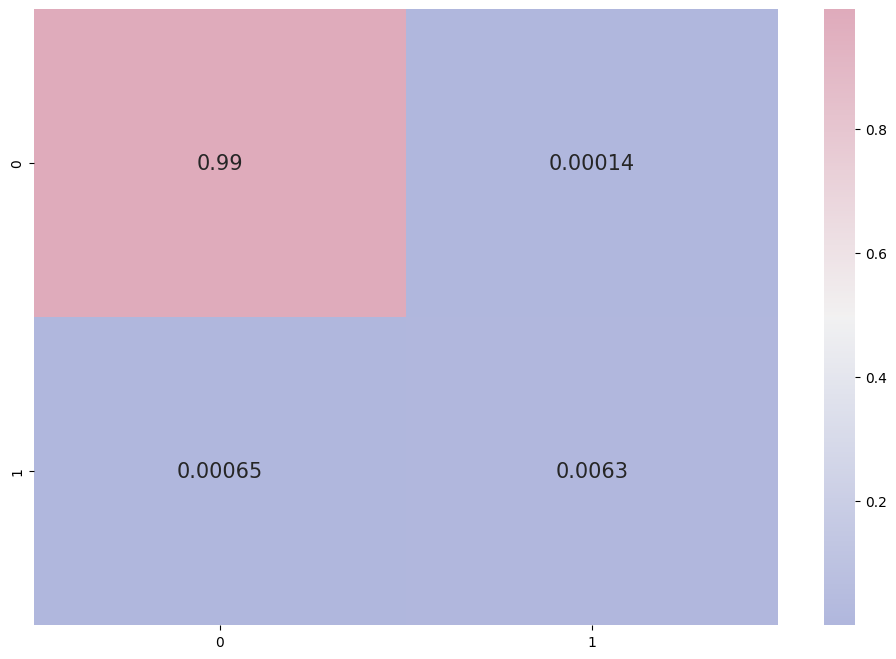

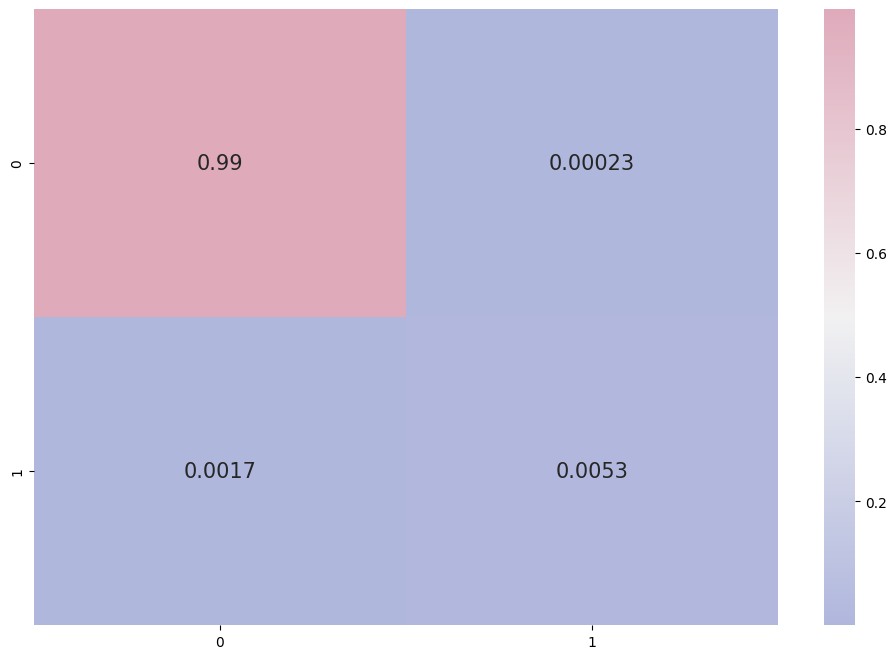

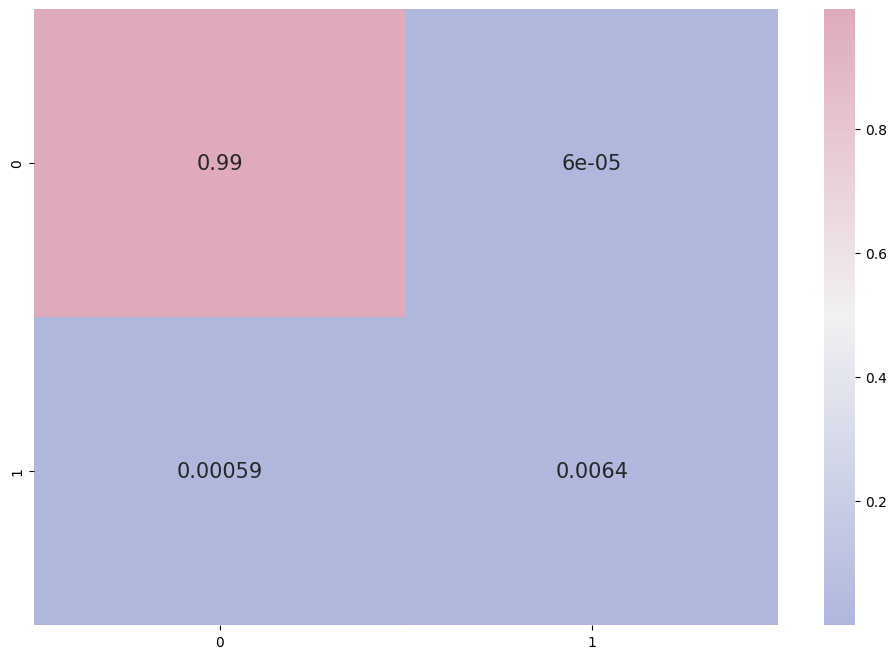

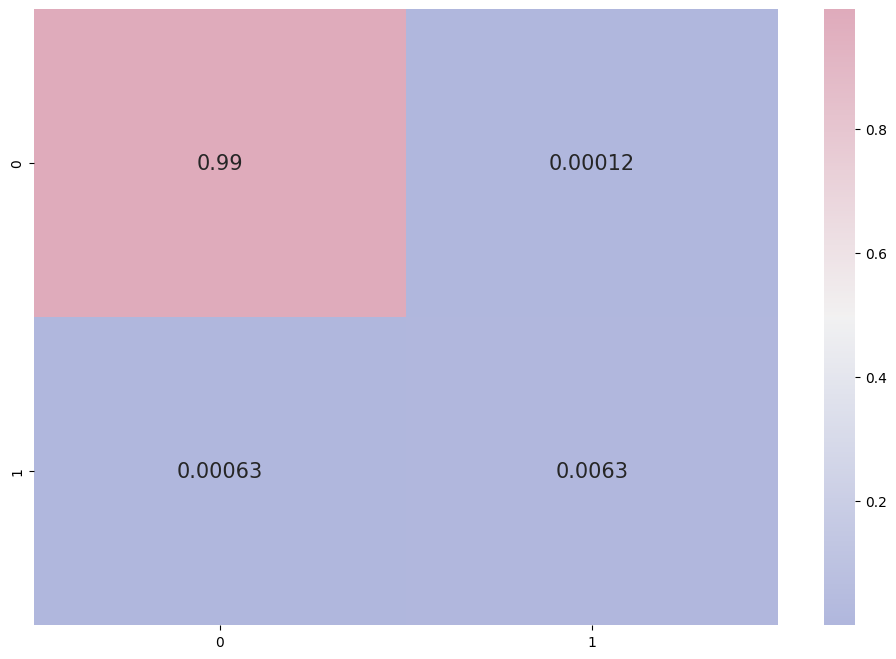

In [28]:
#random
classSuper(train_set1,test_set1)

In [42]:
from sklearn.manifold import TSNE
from sklearn.datasets import load_iris,load_digits
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import os

data_Value=data.iloc[:,:6]

X_tsne = TSNE(n_components=2,random_state=33).fit_transform(data_Value)
X_pca = PCA(n_components=2).fit_transform(data_Value)

ckpt_dir="image"
if not os.path.exists(ckpt_dir):
    os.makedirs(ckpt_dir)


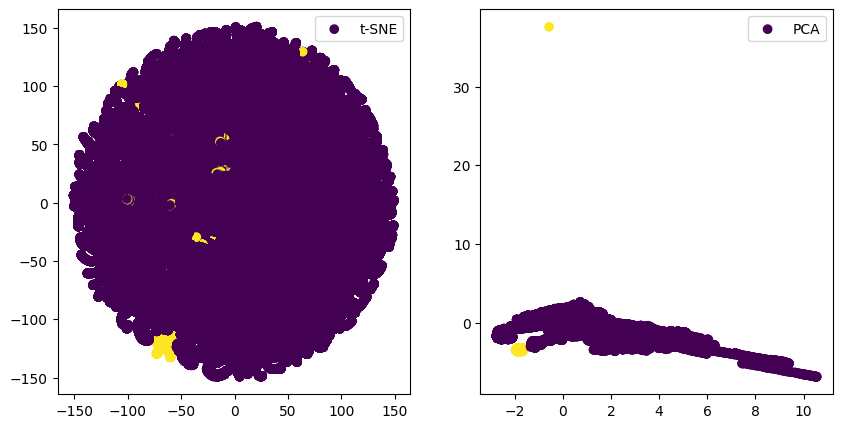

In [43]:
plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=data.qualityflag,label="t-SNE")
plt.legend()
plt.subplot(122)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=data.qualityflag,label="PCA")
plt.legend()
#plt.savefig('images/digits_tsne-pca.png', dpi=120)
plt.show()

In [33]:
data2=pd.read_csv("./dataset/6903102_all.csv")

In [36]:
data2_Value=data2.iloc[:,:6]

In [37]:
X2_tsne = TSNE(n_components=2,random_state=33).fit_transform(data2_Value)
X2_pca = PCA(n_components=2).fit_transform(data2_Value)

ckpt_dir="image"
if not os.path.exists(ckpt_dir):
    os.makedirs(ckpt_dir)


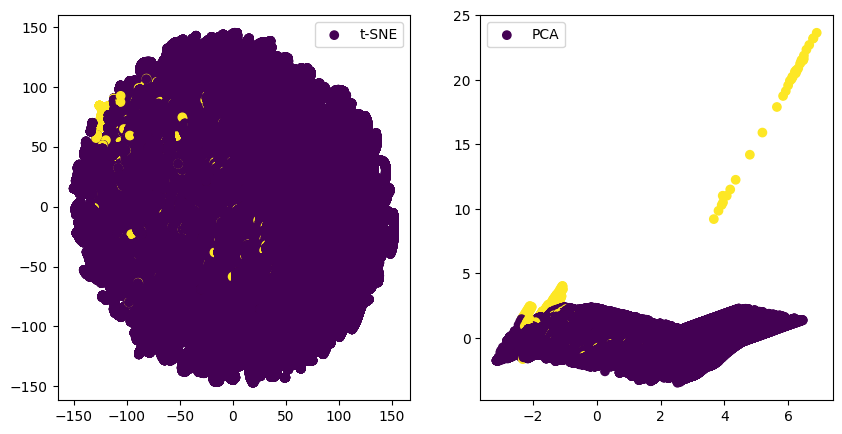

In [45]:
plt.figure(figsize=(10, 5))
plt.subplot(121)
plt.scatter(X2_tsne[:, 0], X2_tsne[:, 1], c=data2.label,label="t-SNE")
plt.legend()
plt.subplot(122)
plt.scatter(X2_pca[:, 0], X2_pca[:, 1], c=data2.label,label="PCA")
plt.legend()
#plt.savefig('images/digits_tsne-pca.png', dpi=120)
plt.show()

In [ ]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set1.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.3,0.4,0.5,]
mccList=[]
plt.title(title1)
ylim=[0.7,1.0]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    train_set = train_set1.sample(frac=size)
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set1.iloc[:,0:y-1])
    y_tru=test_set1.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()

## Last

error reason: some predict label type do not exist in training set.

In [ ]:
print(train_set2)
print(test_set2)

In [ ]:
#last
classSuper(train_set2,test_set2)

In [ ]:
#learning curve
model = lgb.LGBMClassifier()
title1 = "LightGBM"
plt.subplot(121)
x,y=train_set2.shape
train_sizes=[0.01,0.02,0.03,0.04,0.05,0.06,0.1,0.2,0.25,0.6]
mccList=[]
plt.title(title1)
ylim=[0.0,0.5]
if ylim is not None:
    plt.ylim(*ylim)
for size in train_sizes:
    row=int(size*x)
    train_set  = train_set2[-row:]
    clf = model.fit(train_set.iloc[:,0:y-1],train_set.iloc[:,y-1])
    y_pre=clf.predict(test_set2.iloc[:,0:y-1])
    y_tru=test_set2.iloc[:,y-1]
    #compute metric
    mcc=matthews_corrcoef(y_tru, y_pre)
    mccList.append(mcc)
        

plt.plot(train_sizes, mccList, "o-", color="green", label="MCC score")
plt.legend(loc="best")
plt.show()

In [ ]:
train_set22,test_set22=getRandomSplit(train_set2, 0.1315)
train_set22

In [ ]:
#random
classSuper(train_set22,test_set22)

In [ ]:
classSuper(train_set22,test_set2)

In [ ]:
test_set22